In [471]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import multivariate_normal
import math
np.set_printoptions(threshold=np.inf)

In [803]:
class GMM():
    def __init__(self):
        pass
    
    
    def fit(self, X, n_clusters, max_retries=10, epsilon=0.001):
        assert(n_clusters > 0)
        b_clusters, b_loss = [], float("inf")
        for f in range(max_retries):
            print(f)
            pi = np.ones((n_clusters, 1)) / n_clusters
            sigma = np.array([np.eye(X.shape[1]) * 0.001 for _ in range(n_clusters)])
    #         print(sigma)
            mu = (np.random.rand(n_clusters, X.shape[1]) * (np.amax(X, axis=0) - np.amin(X, axis=0)) + np.amin(X, axis=0))
    #         print(sigma, mu)
            w = np.zeros((n_clusters, X.shape[0]), dtype=np.float64)
            print("SIGMA")
            for x in range(n_clusters):
                print(sigma[x])
            print("MU")
            for x in range(n_clusters):
                print(mu[x])
            for fg in range(1000): # replace with termination when loss < epsilon
                print("FG", fg)
                # expectation step
                for i in range(len(X)):
                    for j in range(n_clusters):
                        w[j][i] = math.sqrt(np.linalg.det(np.linalg.inv(sigma[j])))
#                         print((X[i] - mu[j]).shape, (X[i] - mu[j])[None,:].shape)
#                         print((X[i] - mu[j])[None,:] @ np.linalg.inv(sigma[j]) @ (X[i] - mu[j])[:, None], math.exp(-0.5 * (X[i] - mu[j])[None,:] @ np.linalg.inv(sigma[j]) @ (X[i] - mu[j])[:, None]), math.sqrt(np.linalg.det(np.linalg.inv(sigma[j]))) * math.exp(-0.5 * (X[i] - mu[j])[None,:] @ np.linalg.inv(sigma[j]) @ (X[i] - mu[j])[:, None]))
                        w[j][i] *= math.exp(-0.05 * (X[i] - mu[j])[None,:] @ np.linalg.inv(sigma[j]) @ (X[i] - mu[j])[:, None])
                w *= pi
#                 w = np.maximum(0.000000000001, w)
                print("FIRST W", w)
                w /= np.sum(w, axis=0)[None, :]
                print("SECOND W", w)
                # maximization step
                n = np.sum(w, axis=1)[:,None]
                pi = n / np.sum(n)
#                 print((w @ X).shape, n.shape)
#                 print(w.shape, X.shape)
                mu = (w @ X) / n
                for j in range(n_clusters):
#                     print(((X - mu[j]).T @ (X - mu[j])).shape, w[j].shape)
                    print(sigma.shape, n.shape, n[:, :, None].shape)
                    sigma[j] = np.dot(np.array([(X[i] - mu[j]) @ (X[i] - mu[j]).T for i in range(len(X))]), w[j][:, None])
                sigma /= n[:, :, None]
                sigma += 0.00000001 * np.eye(data.shape[1])
            self.pi = pi
            self.mu = mu
            self.sigma = sigma

In [804]:
np.random.seed(42)

In [805]:
cluster1 = np.random.normal(size=(200, 2)) * 0.0003 - np.array([0.004, -0.0005])
cluster2 = np.random.normal(size=(100, 2)) * 0.0005 - np.array([-0.0005, -0.0005])
cluster3 = np.random.normal(size=(50, 2)) * 0.0002 - np.array([0, 0.005])
data = np.vstack((cluster1, cluster2, cluster3))

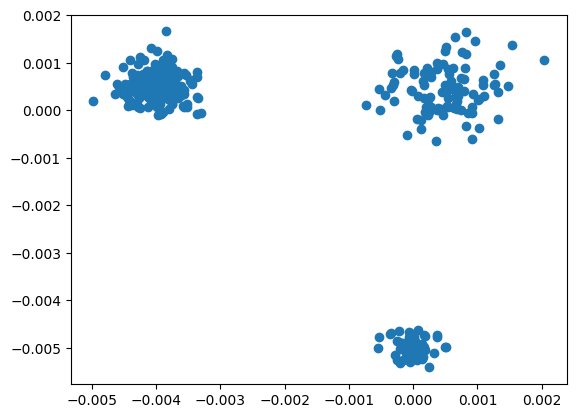

In [806]:
plt.scatter(*(data.T))

In [807]:
gmm = GMM()
gmm.fit(data, 3, max_retries=1)

0
SIGMA
[[0.001 0.   ]
 [0.    0.001]]
[[0.001 0.   ]
 [0.    0.001]]
[[0.001 0.   ]
 [0.    0.001]]
MU
[ 0.00075939 -0.00299786]
[-0.00315335 -0.00273006]
[-0.00083334 -0.00351933]
FG 0
FIRST W [[332.78042401 332.72588491 332.74928018 332.79601316 332.71037544
  332.74599216 332.82513565 332.68515313 332.69162199 332.75434563
  332.82662697 332.80230821 332.7221956  332.68240272 332.73337497
  332.65346403 332.78701151 332.83086688 332.82493619 332.67972481
  332.78063579 332.75725721 332.70323739 332.69161059 332.82545738
  332.78085928 332.69763233 332.76596929 332.72212227 332.73247983
  332.73571544 332.73762433 332.73989824 332.71241808 332.79128467
  332.71212405 332.69239563 332.58798074 332.76682509 332.82023351
  332.72922493 332.83704459 332.73014655 332.7829909  332.70849039
  332.72176548 332.72958167 332.78143057 332.75711389 332.76074552
  332.69657611 332.76298513 332.73033967 332.83054858 332.76712232
  332.65665671 332.66016657 332.73253415 332.78950709 332.77763322
 

SECOND W [[1.27748851e-085 1.89385382e-094 2.46040144e-089 1.42420202e-084
  2.92948964e-095 2.55183420e-089 1.03125679e-076 3.99909088e-096
  4.21724828e-097 2.28238772e-086 1.96040386e-079 1.34991549e-080
  3.59461888e-093 2.86504545e-098 3.84528403e-091 1.07256135e-103
  3.20436148e-083 2.24014753e-077 1.23587320e-076 2.94414103e-098
  5.13318539e-086 2.99465366e-088 9.22613437e-094 3.21595644e-098
  5.32908724e-077 3.47262653e-085 7.05144435e-097 9.59420438e-089
  1.96245343e-092 4.19241355e-093 4.72107575e-091 8.56503128e-089
  1.65291727e-092 1.24890197e-095 1.91782560e-083 3.24504281e-096
  1.06565896e-098 1.80954989e-109 4.46517621e-087 3.72790674e-077
  1.03315193e-092 1.18721791e-077 3.98817184e-091 6.70533236e-086
  1.92964079e-095 1.95401265e-094 1.59494701e-091 4.69797661e-083
  3.94010013e-089 6.21308890e-088 3.79464606e-095 1.21465485e-086
  1.20549160e-092 2.61175935e-079 2.15282600e-087 2.12512460e-100
  2.18977701e-103 3.15665348e-092 1.07643751e-082 4.84751296e-087
 

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

SECOND W [[8.64881908e-095 3.20963031e-104 1.14297555e-098 8.20432402e-094
  6.04136416e-105 1.24357343e-098 2.65128882e-085 9.13534164e-106
  7.48641283e-107 1.80197753e-095 2.58354045e-088 2.06751283e-089
  1.02260974e-102 4.41869305e-108 1.48191754e-100 6.49313100e-114
  3.43076188e-092 4.71205506e-086 3.22852391e-085 4.70138342e-108
  3.07454627e-095 1.58793142e-097 2.82872862e-103 4.26940109e-108
  1.29493768e-085 2.61200253e-094 1.20336101e-106 3.47100195e-098
  6.57204789e-102 9.65357325e-103 1.79971586e-100 4.96510444e-098
  3.58485706e-102 2.20175995e-105 1.84484197e-092 4.59556870e-106
  1.16698617e-108 7.35345467e-120 2.68744951e-096 9.21292092e-086
  2.92138757e-102 2.04133746e-086 1.59908746e-100 3.88740083e-095
  3.92976894e-105 3.93419296e-104 5.93122725e-101 5.47579744e-092
  1.66594721e-098 3.36082303e-097 9.51957508e-105 8.48047727e-096
  3.39443902e-102 3.07873006e-088 1.18904420e-096 2.75910750e-110
  1.12375519e-113 9.52456524e-102 1.24668609e-091 2.20086372e-096
 

SECOND W [[8.64881908e-095 3.20963031e-104 1.14297555e-098 8.20432402e-094
  6.04136416e-105 1.24357343e-098 2.65128882e-085 9.13534164e-106
  7.48641283e-107 1.80197753e-095 2.58354045e-088 2.06751283e-089
  1.02260974e-102 4.41869305e-108 1.48191754e-100 6.49313100e-114
  3.43076188e-092 4.71205506e-086 3.22852391e-085 4.70138342e-108
  3.07454627e-095 1.58793142e-097 2.82872862e-103 4.26940109e-108
  1.29493768e-085 2.61200253e-094 1.20336101e-106 3.47100195e-098
  6.57204789e-102 9.65357325e-103 1.79971586e-100 4.96510444e-098
  3.58485706e-102 2.20175995e-105 1.84484197e-092 4.59556870e-106
  1.16698617e-108 7.35345467e-120 2.68744951e-096 9.21292092e-086
  2.92138757e-102 2.04133746e-086 1.59908746e-100 3.88740083e-095
  3.92976894e-105 3.93419296e-104 5.93122725e-101 5.47579744e-092
  1.66594721e-098 3.36082303e-097 9.51957508e-105 8.48047727e-096
  3.39443902e-102 3.07873006e-088 1.18904420e-096 2.75910750e-110
  1.12375519e-113 9.52456524e-102 1.24668609e-091 2.20086372e-096
 

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

SECOND W [[8.64881908e-095 3.20963031e-104 1.14297555e-098 8.20432402e-094
  6.04136416e-105 1.24357343e-098 2.65128882e-085 9.13534164e-106
  7.48641283e-107 1.80197753e-095 2.58354045e-088 2.06751283e-089
  1.02260974e-102 4.41869305e-108 1.48191754e-100 6.49313100e-114
  3.43076188e-092 4.71205506e-086 3.22852391e-085 4.70138342e-108
  3.07454627e-095 1.58793142e-097 2.82872862e-103 4.26940109e-108
  1.29493768e-085 2.61200253e-094 1.20336101e-106 3.47100195e-098
  6.57204789e-102 9.65357325e-103 1.79971586e-100 4.96510444e-098
  3.58485706e-102 2.20175995e-105 1.84484197e-092 4.59556870e-106
  1.16698617e-108 7.35345467e-120 2.68744951e-096 9.21292092e-086
  2.92138757e-102 2.04133746e-086 1.59908746e-100 3.88740083e-095
  3.92976894e-105 3.93419296e-104 5.93122725e-101 5.47579744e-092
  1.66594721e-098 3.36082303e-097 9.51957508e-105 8.48047727e-096
  3.39443902e-102 3.07873006e-088 1.18904420e-096 2.75910750e-110
  1.12375519e-113 9.52456524e-102 1.24668609e-091 2.20086372e-096
 

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

SECOND W [[8.64881908e-095 3.20963031e-104 1.14297555e-098 8.20432402e-094
  6.04136416e-105 1.24357343e-098 2.65128882e-085 9.13534164e-106
  7.48641283e-107 1.80197753e-095 2.58354045e-088 2.06751283e-089
  1.02260974e-102 4.41869305e-108 1.48191754e-100 6.49313100e-114
  3.43076188e-092 4.71205506e-086 3.22852391e-085 4.70138342e-108
  3.07454627e-095 1.58793142e-097 2.82872862e-103 4.26940109e-108
  1.29493768e-085 2.61200253e-094 1.20336101e-106 3.47100195e-098
  6.57204789e-102 9.65357325e-103 1.79971586e-100 4.96510444e-098
  3.58485706e-102 2.20175995e-105 1.84484197e-092 4.59556870e-106
  1.16698617e-108 7.35345467e-120 2.68744951e-096 9.21292092e-086
  2.92138757e-102 2.04133746e-086 1.59908746e-100 3.88740083e-095
  3.92976894e-105 3.93419296e-104 5.93122725e-101 5.47579744e-092
  1.66594721e-098 3.36082303e-097 9.51957508e-105 8.48047727e-096
  3.39443902e-102 3.07873006e-088 1.18904420e-096 2.75910750e-110
  1.12375519e-113 9.52456524e-102 1.24668609e-091 2.20086372e-096
 

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

SECOND W [[8.64881908e-095 3.20963031e-104 1.14297555e-098 8.20432402e-094
  6.04136416e-105 1.24357343e-098 2.65128882e-085 9.13534164e-106
  7.48641283e-107 1.80197753e-095 2.58354045e-088 2.06751283e-089
  1.02260974e-102 4.41869305e-108 1.48191754e-100 6.49313100e-114
  3.43076188e-092 4.71205506e-086 3.22852391e-085 4.70138342e-108
  3.07454627e-095 1.58793142e-097 2.82872862e-103 4.26940109e-108
  1.29493768e-085 2.61200253e-094 1.20336101e-106 3.47100195e-098
  6.57204789e-102 9.65357325e-103 1.79971586e-100 4.96510444e-098
  3.58485706e-102 2.20175995e-105 1.84484197e-092 4.59556870e-106
  1.16698617e-108 7.35345467e-120 2.68744951e-096 9.21292092e-086
  2.92138757e-102 2.04133746e-086 1.59908746e-100 3.88740083e-095
  3.92976894e-105 3.93419296e-104 5.93122725e-101 5.47579744e-092
  1.66594721e-098 3.36082303e-097 9.51957508e-105 8.48047727e-096
  3.39443902e-102 3.07873006e-088 1.18904420e-096 2.75910750e-110
  1.12375519e-113 9.52456524e-102 1.24668609e-091 2.20086372e-096
 

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

SECOND W [[8.64881908e-095 3.20963031e-104 1.14297555e-098 8.20432402e-094
  6.04136416e-105 1.24357343e-098 2.65128882e-085 9.13534164e-106
  7.48641283e-107 1.80197753e-095 2.58354045e-088 2.06751283e-089
  1.02260974e-102 4.41869305e-108 1.48191754e-100 6.49313100e-114
  3.43076188e-092 4.71205506e-086 3.22852391e-085 4.70138342e-108
  3.07454627e-095 1.58793142e-097 2.82872862e-103 4.26940109e-108
  1.29493768e-085 2.61200253e-094 1.20336101e-106 3.47100195e-098
  6.57204789e-102 9.65357325e-103 1.79971586e-100 4.96510444e-098
  3.58485706e-102 2.20175995e-105 1.84484197e-092 4.59556870e-106
  1.16698617e-108 7.35345467e-120 2.68744951e-096 9.21292092e-086
  2.92138757e-102 2.04133746e-086 1.59908746e-100 3.88740083e-095
  3.92976894e-105 3.93419296e-104 5.93122725e-101 5.47579744e-092
  1.66594721e-098 3.36082303e-097 9.51957508e-105 8.48047727e-096
  3.39443902e-102 3.07873006e-088 1.18904420e-096 2.75910750e-110
  1.12375519e-113 9.52456524e-102 1.24668609e-091 2.20086372e-096
 

SECOND W [[8.64881908e-095 3.20963031e-104 1.14297555e-098 8.20432402e-094
  6.04136416e-105 1.24357343e-098 2.65128882e-085 9.13534164e-106
  7.48641283e-107 1.80197753e-095 2.58354045e-088 2.06751283e-089
  1.02260974e-102 4.41869305e-108 1.48191754e-100 6.49313100e-114
  3.43076188e-092 4.71205506e-086 3.22852391e-085 4.70138342e-108
  3.07454627e-095 1.58793142e-097 2.82872862e-103 4.26940109e-108
  1.29493768e-085 2.61200253e-094 1.20336101e-106 3.47100195e-098
  6.57204789e-102 9.65357325e-103 1.79971586e-100 4.96510444e-098
  3.58485706e-102 2.20175995e-105 1.84484197e-092 4.59556870e-106
  1.16698617e-108 7.35345467e-120 2.68744951e-096 9.21292092e-086
  2.92138757e-102 2.04133746e-086 1.59908746e-100 3.88740083e-095
  3.92976894e-105 3.93419296e-104 5.93122725e-101 5.47579744e-092
  1.66594721e-098 3.36082303e-097 9.51957508e-105 8.48047727e-096
  3.39443902e-102 3.07873006e-088 1.18904420e-096 2.75910750e-110
  1.12375519e-113 9.52456524e-102 1.24668609e-091 2.20086372e-096
 

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

SECOND W [[8.64881908e-095 3.20963031e-104 1.14297555e-098 8.20432402e-094
  6.04136416e-105 1.24357343e-098 2.65128882e-085 9.13534164e-106
  7.48641283e-107 1.80197753e-095 2.58354045e-088 2.06751283e-089
  1.02260974e-102 4.41869305e-108 1.48191754e-100 6.49313100e-114
  3.43076188e-092 4.71205506e-086 3.22852391e-085 4.70138342e-108
  3.07454627e-095 1.58793142e-097 2.82872862e-103 4.26940109e-108
  1.29493768e-085 2.61200253e-094 1.20336101e-106 3.47100195e-098
  6.57204789e-102 9.65357325e-103 1.79971586e-100 4.96510444e-098
  3.58485706e-102 2.20175995e-105 1.84484197e-092 4.59556870e-106
  1.16698617e-108 7.35345467e-120 2.68744951e-096 9.21292092e-086
  2.92138757e-102 2.04133746e-086 1.59908746e-100 3.88740083e-095
  3.92976894e-105 3.93419296e-104 5.93122725e-101 5.47579744e-092
  1.66594721e-098 3.36082303e-097 9.51957508e-105 8.48047727e-096
  3.39443902e-102 3.07873006e-088 1.18904420e-096 2.75910750e-110
  1.12375519e-113 9.52456524e-102 1.24668609e-091 2.20086372e-096
 

SECOND W [[8.64881908e-095 3.20963031e-104 1.14297555e-098 8.20432402e-094
  6.04136416e-105 1.24357343e-098 2.65128882e-085 9.13534164e-106
  7.48641283e-107 1.80197753e-095 2.58354045e-088 2.06751283e-089
  1.02260974e-102 4.41869305e-108 1.48191754e-100 6.49313100e-114
  3.43076188e-092 4.71205506e-086 3.22852391e-085 4.70138342e-108
  3.07454627e-095 1.58793142e-097 2.82872862e-103 4.26940109e-108
  1.29493768e-085 2.61200253e-094 1.20336101e-106 3.47100195e-098
  6.57204789e-102 9.65357325e-103 1.79971586e-100 4.96510444e-098
  3.58485706e-102 2.20175995e-105 1.84484197e-092 4.59556870e-106
  1.16698617e-108 7.35345467e-120 2.68744951e-096 9.21292092e-086
  2.92138757e-102 2.04133746e-086 1.59908746e-100 3.88740083e-095
  3.92976894e-105 3.93419296e-104 5.93122725e-101 5.47579744e-092
  1.66594721e-098 3.36082303e-097 9.51957508e-105 8.48047727e-096
  3.39443902e-102 3.07873006e-088 1.18904420e-096 2.75910750e-110
  1.12375519e-113 9.52456524e-102 1.24668609e-091 2.20086372e-096
 

FG 173
FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e

SECOND W [[8.64881908e-095 3.20963031e-104 1.14297555e-098 8.20432402e-094
  6.04136416e-105 1.24357343e-098 2.65128882e-085 9.13534164e-106
  7.48641283e-107 1.80197753e-095 2.58354045e-088 2.06751283e-089
  1.02260974e-102 4.41869305e-108 1.48191754e-100 6.49313100e-114
  3.43076188e-092 4.71205506e-086 3.22852391e-085 4.70138342e-108
  3.07454627e-095 1.58793142e-097 2.82872862e-103 4.26940109e-108
  1.29493768e-085 2.61200253e-094 1.20336101e-106 3.47100195e-098
  6.57204789e-102 9.65357325e-103 1.79971586e-100 4.96510444e-098
  3.58485706e-102 2.20175995e-105 1.84484197e-092 4.59556870e-106
  1.16698617e-108 7.35345467e-120 2.68744951e-096 9.21292092e-086
  2.92138757e-102 2.04133746e-086 1.59908746e-100 3.88740083e-095
  3.92976894e-105 3.93419296e-104 5.93122725e-101 5.47579744e-092
  1.66594721e-098 3.36082303e-097 9.51957508e-105 8.48047727e-096
  3.39443902e-102 3.07873006e-088 1.18904420e-096 2.75910750e-110
  1.12375519e-113 9.52456524e-102 1.24668609e-091 2.20086372e-096
 

(3, 2, 2) (3, 1) (3, 1, 1)
(3, 2, 2) (3, 1) (3, 1, 1)
FG 185
FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.981

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

SECOND W [[8.64881908e-095 3.20963031e-104 1.14297555e-098 8.20432402e-094
  6.04136416e-105 1.24357343e-098 2.65128882e-085 9.13534164e-106
  7.48641283e-107 1.80197753e-095 2.58354045e-088 2.06751283e-089
  1.02260974e-102 4.41869305e-108 1.48191754e-100 6.49313100e-114
  3.43076188e-092 4.71205506e-086 3.22852391e-085 4.70138342e-108
  3.07454627e-095 1.58793142e-097 2.82872862e-103 4.26940109e-108
  1.29493768e-085 2.61200253e-094 1.20336101e-106 3.47100195e-098
  6.57204789e-102 9.65357325e-103 1.79971586e-100 4.96510444e-098
  3.58485706e-102 2.20175995e-105 1.84484197e-092 4.59556870e-106
  1.16698617e-108 7.35345467e-120 2.68744951e-096 9.21292092e-086
  2.92138757e-102 2.04133746e-086 1.59908746e-100 3.88740083e-095
  3.92976894e-105 3.93419296e-104 5.93122725e-101 5.47579744e-092
  1.66594721e-098 3.36082303e-097 9.51957508e-105 8.48047727e-096
  3.39443902e-102 3.07873006e-088 1.18904420e-096 2.75910750e-110
  1.12375519e-113 9.52456524e-102 1.24668609e-091 2.20086372e-096
 

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

SECOND W [[8.64881908e-095 3.20963031e-104 1.14297555e-098 8.20432402e-094
  6.04136416e-105 1.24357343e-098 2.65128882e-085 9.13534164e-106
  7.48641283e-107 1.80197753e-095 2.58354045e-088 2.06751283e-089
  1.02260974e-102 4.41869305e-108 1.48191754e-100 6.49313100e-114
  3.43076188e-092 4.71205506e-086 3.22852391e-085 4.70138342e-108
  3.07454627e-095 1.58793142e-097 2.82872862e-103 4.26940109e-108
  1.29493768e-085 2.61200253e-094 1.20336101e-106 3.47100195e-098
  6.57204789e-102 9.65357325e-103 1.79971586e-100 4.96510444e-098
  3.58485706e-102 2.20175995e-105 1.84484197e-092 4.59556870e-106
  1.16698617e-108 7.35345467e-120 2.68744951e-096 9.21292092e-086
  2.92138757e-102 2.04133746e-086 1.59908746e-100 3.88740083e-095
  3.92976894e-105 3.93419296e-104 5.93122725e-101 5.47579744e-092
  1.66594721e-098 3.36082303e-097 9.51957508e-105 8.48047727e-096
  3.39443902e-102 3.07873006e-088 1.18904420e-096 2.75910750e-110
  1.12375519e-113 9.52456524e-102 1.24668609e-091 2.20086372e-096
 

SECOND W [[8.64881908e-095 3.20963031e-104 1.14297555e-098 8.20432402e-094
  6.04136416e-105 1.24357343e-098 2.65128882e-085 9.13534164e-106
  7.48641283e-107 1.80197753e-095 2.58354045e-088 2.06751283e-089
  1.02260974e-102 4.41869305e-108 1.48191754e-100 6.49313100e-114
  3.43076188e-092 4.71205506e-086 3.22852391e-085 4.70138342e-108
  3.07454627e-095 1.58793142e-097 2.82872862e-103 4.26940109e-108
  1.29493768e-085 2.61200253e-094 1.20336101e-106 3.47100195e-098
  6.57204789e-102 9.65357325e-103 1.79971586e-100 4.96510444e-098
  3.58485706e-102 2.20175995e-105 1.84484197e-092 4.59556870e-106
  1.16698617e-108 7.35345467e-120 2.68744951e-096 9.21292092e-086
  2.92138757e-102 2.04133746e-086 1.59908746e-100 3.88740083e-095
  3.92976894e-105 3.93419296e-104 5.93122725e-101 5.47579744e-092
  1.66594721e-098 3.36082303e-097 9.51957508e-105 8.48047727e-096
  3.39443902e-102 3.07873006e-088 1.18904420e-096 2.75910750e-110
  1.12375519e-113 9.52456524e-102 1.24668609e-091 2.20086372e-096
 

SECOND W [[8.64881908e-095 3.20963031e-104 1.14297555e-098 8.20432402e-094
  6.04136416e-105 1.24357343e-098 2.65128882e-085 9.13534164e-106
  7.48641283e-107 1.80197753e-095 2.58354045e-088 2.06751283e-089
  1.02260974e-102 4.41869305e-108 1.48191754e-100 6.49313100e-114
  3.43076188e-092 4.71205506e-086 3.22852391e-085 4.70138342e-108
  3.07454627e-095 1.58793142e-097 2.82872862e-103 4.26940109e-108
  1.29493768e-085 2.61200253e-094 1.20336101e-106 3.47100195e-098
  6.57204789e-102 9.65357325e-103 1.79971586e-100 4.96510444e-098
  3.58485706e-102 2.20175995e-105 1.84484197e-092 4.59556870e-106
  1.16698617e-108 7.35345467e-120 2.68744951e-096 9.21292092e-086
  2.92138757e-102 2.04133746e-086 1.59908746e-100 3.88740083e-095
  3.92976894e-105 3.93419296e-104 5.93122725e-101 5.47579744e-092
  1.66594721e-098 3.36082303e-097 9.51957508e-105 8.48047727e-096
  3.39443902e-102 3.07873006e-088 1.18904420e-096 2.75910750e-110
  1.12375519e-113 9.52456524e-102 1.24668609e-091 2.20086372e-096
 

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FG 271
FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

SECOND W [[8.64881908e-095 3.20963031e-104 1.14297555e-098 8.20432402e-094
  6.04136416e-105 1.24357343e-098 2.65128882e-085 9.13534164e-106
  7.48641283e-107 1.80197753e-095 2.58354045e-088 2.06751283e-089
  1.02260974e-102 4.41869305e-108 1.48191754e-100 6.49313100e-114
  3.43076188e-092 4.71205506e-086 3.22852391e-085 4.70138342e-108
  3.07454627e-095 1.58793142e-097 2.82872862e-103 4.26940109e-108
  1.29493768e-085 2.61200253e-094 1.20336101e-106 3.47100195e-098
  6.57204789e-102 9.65357325e-103 1.79971586e-100 4.96510444e-098
  3.58485706e-102 2.20175995e-105 1.84484197e-092 4.59556870e-106
  1.16698617e-108 7.35345467e-120 2.68744951e-096 9.21292092e-086
  2.92138757e-102 2.04133746e-086 1.59908746e-100 3.88740083e-095
  3.92976894e-105 3.93419296e-104 5.93122725e-101 5.47579744e-092
  1.66594721e-098 3.36082303e-097 9.51957508e-105 8.48047727e-096
  3.39443902e-102 3.07873006e-088 1.18904420e-096 2.75910750e-110
  1.12375519e-113 9.52456524e-102 1.24668609e-091 2.20086372e-096
 

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

SECOND W [[8.64881908e-095 3.20963031e-104 1.14297555e-098 8.20432402e-094
  6.04136416e-105 1.24357343e-098 2.65128882e-085 9.13534164e-106
  7.48641283e-107 1.80197753e-095 2.58354045e-088 2.06751283e-089
  1.02260974e-102 4.41869305e-108 1.48191754e-100 6.49313100e-114
  3.43076188e-092 4.71205506e-086 3.22852391e-085 4.70138342e-108
  3.07454627e-095 1.58793142e-097 2.82872862e-103 4.26940109e-108
  1.29493768e-085 2.61200253e-094 1.20336101e-106 3.47100195e-098
  6.57204789e-102 9.65357325e-103 1.79971586e-100 4.96510444e-098
  3.58485706e-102 2.20175995e-105 1.84484197e-092 4.59556870e-106
  1.16698617e-108 7.35345467e-120 2.68744951e-096 9.21292092e-086
  2.92138757e-102 2.04133746e-086 1.59908746e-100 3.88740083e-095
  3.92976894e-105 3.93419296e-104 5.93122725e-101 5.47579744e-092
  1.66594721e-098 3.36082303e-097 9.51957508e-105 8.48047727e-096
  3.39443902e-102 3.07873006e-088 1.18904420e-096 2.75910750e-110
  1.12375519e-113 9.52456524e-102 1.24668609e-091 2.20086372e-096
 

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

(3, 2, 2) (3, 1) (3, 1, 1)
(3, 2, 2) (3, 1) (3, 1, 1)
FG 377
FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.981

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

SECOND W [[8.64881908e-095 3.20963031e-104 1.14297555e-098 8.20432402e-094
  6.04136416e-105 1.24357343e-098 2.65128882e-085 9.13534164e-106
  7.48641283e-107 1.80197753e-095 2.58354045e-088 2.06751283e-089
  1.02260974e-102 4.41869305e-108 1.48191754e-100 6.49313100e-114
  3.43076188e-092 4.71205506e-086 3.22852391e-085 4.70138342e-108
  3.07454627e-095 1.58793142e-097 2.82872862e-103 4.26940109e-108
  1.29493768e-085 2.61200253e-094 1.20336101e-106 3.47100195e-098
  6.57204789e-102 9.65357325e-103 1.79971586e-100 4.96510444e-098
  3.58485706e-102 2.20175995e-105 1.84484197e-092 4.59556870e-106
  1.16698617e-108 7.35345467e-120 2.68744951e-096 9.21292092e-086
  2.92138757e-102 2.04133746e-086 1.59908746e-100 3.88740083e-095
  3.92976894e-105 3.93419296e-104 5.93122725e-101 5.47579744e-092
  1.66594721e-098 3.36082303e-097 9.51957508e-105 8.48047727e-096
  3.39443902e-102 3.07873006e-088 1.18904420e-096 2.75910750e-110
  1.12375519e-113 9.52456524e-102 1.24668609e-091 2.20086372e-096
 

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

SECOND W [[8.64881908e-095 3.20963031e-104 1.14297555e-098 8.20432402e-094
  6.04136416e-105 1.24357343e-098 2.65128882e-085 9.13534164e-106
  7.48641283e-107 1.80197753e-095 2.58354045e-088 2.06751283e-089
  1.02260974e-102 4.41869305e-108 1.48191754e-100 6.49313100e-114
  3.43076188e-092 4.71205506e-086 3.22852391e-085 4.70138342e-108
  3.07454627e-095 1.58793142e-097 2.82872862e-103 4.26940109e-108
  1.29493768e-085 2.61200253e-094 1.20336101e-106 3.47100195e-098
  6.57204789e-102 9.65357325e-103 1.79971586e-100 4.96510444e-098
  3.58485706e-102 2.20175995e-105 1.84484197e-092 4.59556870e-106
  1.16698617e-108 7.35345467e-120 2.68744951e-096 9.21292092e-086
  2.92138757e-102 2.04133746e-086 1.59908746e-100 3.88740083e-095
  3.92976894e-105 3.93419296e-104 5.93122725e-101 5.47579744e-092
  1.66594721e-098 3.36082303e-097 9.51957508e-105 8.48047727e-096
  3.39443902e-102 3.07873006e-088 1.18904420e-096 2.75910750e-110
  1.12375519e-113 9.52456524e-102 1.24668609e-091 2.20086372e-096
 

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

SECOND W [[8.64881908e-095 3.20963031e-104 1.14297555e-098 8.20432402e-094
  6.04136416e-105 1.24357343e-098 2.65128882e-085 9.13534164e-106
  7.48641283e-107 1.80197753e-095 2.58354045e-088 2.06751283e-089
  1.02260974e-102 4.41869305e-108 1.48191754e-100 6.49313100e-114
  3.43076188e-092 4.71205506e-086 3.22852391e-085 4.70138342e-108
  3.07454627e-095 1.58793142e-097 2.82872862e-103 4.26940109e-108
  1.29493768e-085 2.61200253e-094 1.20336101e-106 3.47100195e-098
  6.57204789e-102 9.65357325e-103 1.79971586e-100 4.96510444e-098
  3.58485706e-102 2.20175995e-105 1.84484197e-092 4.59556870e-106
  1.16698617e-108 7.35345467e-120 2.68744951e-096 9.21292092e-086
  2.92138757e-102 2.04133746e-086 1.59908746e-100 3.88740083e-095
  3.92976894e-105 3.93419296e-104 5.93122725e-101 5.47579744e-092
  1.66594721e-098 3.36082303e-097 9.51957508e-105 8.48047727e-096
  3.39443902e-102 3.07873006e-088 1.18904420e-096 2.75910750e-110
  1.12375519e-113 9.52456524e-102 1.24668609e-091 2.20086372e-096
 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[8.64881908e-095 3.20963031e-104 1.14297555e-098 8.20432402e-094
  6.04136416e-105 1.24357343e-098 2.65128882e-085 9.13534164e-106
  7.48641283e-107 1.80197753e-095 2.58354045e-088 2.06751283e-089
  1.02260974e-102 4.41869305e-108 1.48191754e-100 6.49313100e-114
  3.43076188e-092 4.71205506e-086 3.22852391e-085 4.70138342e-108
  3.07454627e-095 1.58793142e-097 2.82872862e-103 4.26940109e-108
  1.29493768e-085 2.61200253e-094 1.20336101e-106 3.47100195e-098
  6.57204789e-102 9.65357325e-103 1.79971586e-100 4.96510444e-098
  3.58485706e-102 2.20175995e-105 1.84484197e-092 4.59556870e-106
  1.16698617e-108 7.35345467e-120 2.68744951e-096 9.21292092e-086
  2.92138757e-102 2.04133746e-086 1.59908746e-100 3.88740083e-095
  3.92976894e-105 3.93419296e-104 5.93122725e-101 5.47579744e-092
  1.66594721e-098 3.36082303e-097 9.51957508e-105 8.48047727e-096
  3.39443902e-102 3.07873006e-088 1.18904420e-096 2.75910750e-110
  1.12375519e-113 9.52456524e-102 1.24668609e-091 2.20086372e-096
  3.476874

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[8.64881908e-095 3.20963031e-104 1.14297555e-098 8.20432402e-094
  6.04136416e-105 1.24357343e-098 2.65128882e-085 9.13534164e-106
  7.48641283e-107 1.80197753e-095 2.58354045e-088 2.06751283e-089
  1.02260974e-102 4.41869305e-108 1.48191754e-100 6.49313100e-114
  3.43076188e-092 4.71205506e-086 3.22852391e-085 4.70138342e-108
  3.07454627e-095 1.58793142e-097 2.82872862e-103 4.26940109e-108
  1.29493768e-085 2.61200253e-094 1.20336101e-106 3.47100195e-098
  6.57204789e-102 9.65357325e-103 1.79971586e-100 4.96510444e-098
  3.58485706e-102 2.20175995e-105 1.84484197e-092 4.59556870e-106
  1.16698617e-108 7.35345467e-120 2.68744951e-096 9.21292092e-086
  2.92138757e-102 2.04133746e-086 1.59908746e-100 3.88740083e-095
  3.92976894e-105 3.93419296e-104 5.93122725e-101 5.47579744e-092
  1.66594721e-098 3.36082303e-097 9.51957508e-105 8.48047727e-096
  3.39443902e-102 3.07873006e-088 1.18904420e-096 2.75910750e-110
  1.12375519e-113 9.52456524e-102 1.24668609e-091 2.20086372e-096
  3.476874

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

SECOND W [[8.64881908e-095 3.20963031e-104 1.14297555e-098 8.20432402e-094
  6.04136416e-105 1.24357343e-098 2.65128882e-085 9.13534164e-106
  7.48641283e-107 1.80197753e-095 2.58354045e-088 2.06751283e-089
  1.02260974e-102 4.41869305e-108 1.48191754e-100 6.49313100e-114
  3.43076188e-092 4.71205506e-086 3.22852391e-085 4.70138342e-108
  3.07454627e-095 1.58793142e-097 2.82872862e-103 4.26940109e-108
  1.29493768e-085 2.61200253e-094 1.20336101e-106 3.47100195e-098
  6.57204789e-102 9.65357325e-103 1.79971586e-100 4.96510444e-098
  3.58485706e-102 2.20175995e-105 1.84484197e-092 4.59556870e-106
  1.16698617e-108 7.35345467e-120 2.68744951e-096 9.21292092e-086
  2.92138757e-102 2.04133746e-086 1.59908746e-100 3.88740083e-095
  3.92976894e-105 3.93419296e-104 5.93122725e-101 5.47579744e-092
  1.66594721e-098 3.36082303e-097 9.51957508e-105 8.48047727e-096
  3.39443902e-102 3.07873006e-088 1.18904420e-096 2.75910750e-110
  1.12375519e-113 9.52456524e-102 1.24668609e-091 2.20086372e-096
 

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

SECOND W [[8.64881908e-095 3.20963031e-104 1.14297555e-098 8.20432402e-094
  6.04136416e-105 1.24357343e-098 2.65128882e-085 9.13534164e-106
  7.48641283e-107 1.80197753e-095 2.58354045e-088 2.06751283e-089
  1.02260974e-102 4.41869305e-108 1.48191754e-100 6.49313100e-114
  3.43076188e-092 4.71205506e-086 3.22852391e-085 4.70138342e-108
  3.07454627e-095 1.58793142e-097 2.82872862e-103 4.26940109e-108
  1.29493768e-085 2.61200253e-094 1.20336101e-106 3.47100195e-098
  6.57204789e-102 9.65357325e-103 1.79971586e-100 4.96510444e-098
  3.58485706e-102 2.20175995e-105 1.84484197e-092 4.59556870e-106
  1.16698617e-108 7.35345467e-120 2.68744951e-096 9.21292092e-086
  2.92138757e-102 2.04133746e-086 1.59908746e-100 3.88740083e-095
  3.92976894e-105 3.93419296e-104 5.93122725e-101 5.47579744e-092
  1.66594721e-098 3.36082303e-097 9.51957508e-105 8.48047727e-096
  3.39443902e-102 3.07873006e-088 1.18904420e-096 2.75910750e-110
  1.12375519e-113 9.52456524e-102 1.24668609e-091 2.20086372e-096
 

SECOND W [[8.64881908e-095 3.20963031e-104 1.14297555e-098 8.20432402e-094
  6.04136416e-105 1.24357343e-098 2.65128882e-085 9.13534164e-106
  7.48641283e-107 1.80197753e-095 2.58354045e-088 2.06751283e-089
  1.02260974e-102 4.41869305e-108 1.48191754e-100 6.49313100e-114
  3.43076188e-092 4.71205506e-086 3.22852391e-085 4.70138342e-108
  3.07454627e-095 1.58793142e-097 2.82872862e-103 4.26940109e-108
  1.29493768e-085 2.61200253e-094 1.20336101e-106 3.47100195e-098
  6.57204789e-102 9.65357325e-103 1.79971586e-100 4.96510444e-098
  3.58485706e-102 2.20175995e-105 1.84484197e-092 4.59556870e-106
  1.16698617e-108 7.35345467e-120 2.68744951e-096 9.21292092e-086
  2.92138757e-102 2.04133746e-086 1.59908746e-100 3.88740083e-095
  3.92976894e-105 3.93419296e-104 5.93122725e-101 5.47579744e-092
  1.66594721e-098 3.36082303e-097 9.51957508e-105 8.48047727e-096
  3.39443902e-102 3.07873006e-088 1.18904420e-096 2.75910750e-110
  1.12375519e-113 9.52456524e-102 1.24668609e-091 2.20086372e-096
 

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

SECOND W [[8.64881908e-095 3.20963031e-104 1.14297555e-098 8.20432402e-094
  6.04136416e-105 1.24357343e-098 2.65128882e-085 9.13534164e-106
  7.48641283e-107 1.80197753e-095 2.58354045e-088 2.06751283e-089
  1.02260974e-102 4.41869305e-108 1.48191754e-100 6.49313100e-114
  3.43076188e-092 4.71205506e-086 3.22852391e-085 4.70138342e-108
  3.07454627e-095 1.58793142e-097 2.82872862e-103 4.26940109e-108
  1.29493768e-085 2.61200253e-094 1.20336101e-106 3.47100195e-098
  6.57204789e-102 9.65357325e-103 1.79971586e-100 4.96510444e-098
  3.58485706e-102 2.20175995e-105 1.84484197e-092 4.59556870e-106
  1.16698617e-108 7.35345467e-120 2.68744951e-096 9.21292092e-086
  2.92138757e-102 2.04133746e-086 1.59908746e-100 3.88740083e-095
  3.92976894e-105 3.93419296e-104 5.93122725e-101 5.47579744e-092
  1.66594721e-098 3.36082303e-097 9.51957508e-105 8.48047727e-096
  3.39443902e-102 3.07873006e-088 1.18904420e-096 2.75910750e-110
  1.12375519e-113 9.52456524e-102 1.24668609e-091 2.20086372e-096
 

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

SECOND W [[8.64881908e-095 3.20963031e-104 1.14297555e-098 8.20432402e-094
  6.04136416e-105 1.24357343e-098 2.65128882e-085 9.13534164e-106
  7.48641283e-107 1.80197753e-095 2.58354045e-088 2.06751283e-089
  1.02260974e-102 4.41869305e-108 1.48191754e-100 6.49313100e-114
  3.43076188e-092 4.71205506e-086 3.22852391e-085 4.70138342e-108
  3.07454627e-095 1.58793142e-097 2.82872862e-103 4.26940109e-108
  1.29493768e-085 2.61200253e-094 1.20336101e-106 3.47100195e-098
  6.57204789e-102 9.65357325e-103 1.79971586e-100 4.96510444e-098
  3.58485706e-102 2.20175995e-105 1.84484197e-092 4.59556870e-106
  1.16698617e-108 7.35345467e-120 2.68744951e-096 9.21292092e-086
  2.92138757e-102 2.04133746e-086 1.59908746e-100 3.88740083e-095
  3.92976894e-105 3.93419296e-104 5.93122725e-101 5.47579744e-092
  1.66594721e-098 3.36082303e-097 9.51957508e-105 8.48047727e-096
  3.39443902e-102 3.07873006e-088 1.18904420e-096 2.75910750e-110
  1.12375519e-113 9.52456524e-102 1.24668609e-091 2.20086372e-096
 

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

SECOND W [[8.64881908e-095 3.20963031e-104 1.14297555e-098 8.20432402e-094
  6.04136416e-105 1.24357343e-098 2.65128882e-085 9.13534164e-106
  7.48641283e-107 1.80197753e-095 2.58354045e-088 2.06751283e-089
  1.02260974e-102 4.41869305e-108 1.48191754e-100 6.49313100e-114
  3.43076188e-092 4.71205506e-086 3.22852391e-085 4.70138342e-108
  3.07454627e-095 1.58793142e-097 2.82872862e-103 4.26940109e-108
  1.29493768e-085 2.61200253e-094 1.20336101e-106 3.47100195e-098
  6.57204789e-102 9.65357325e-103 1.79971586e-100 4.96510444e-098
  3.58485706e-102 2.20175995e-105 1.84484197e-092 4.59556870e-106
  1.16698617e-108 7.35345467e-120 2.68744951e-096 9.21292092e-086
  2.92138757e-102 2.04133746e-086 1.59908746e-100 3.88740083e-095
  3.92976894e-105 3.93419296e-104 5.93122725e-101 5.47579744e-092
  1.66594721e-098 3.36082303e-097 9.51957508e-105 8.48047727e-096
  3.39443902e-102 3.07873006e-088 1.18904420e-096 2.75910750e-110
  1.12375519e-113 9.52456524e-102 1.24668609e-091 2.20086372e-096
 

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

SECOND W [[8.64881908e-095 3.20963031e-104 1.14297555e-098 8.20432402e-094
  6.04136416e-105 1.24357343e-098 2.65128882e-085 9.13534164e-106
  7.48641283e-107 1.80197753e-095 2.58354045e-088 2.06751283e-089
  1.02260974e-102 4.41869305e-108 1.48191754e-100 6.49313100e-114
  3.43076188e-092 4.71205506e-086 3.22852391e-085 4.70138342e-108
  3.07454627e-095 1.58793142e-097 2.82872862e-103 4.26940109e-108
  1.29493768e-085 2.61200253e-094 1.20336101e-106 3.47100195e-098
  6.57204789e-102 9.65357325e-103 1.79971586e-100 4.96510444e-098
  3.58485706e-102 2.20175995e-105 1.84484197e-092 4.59556870e-106
  1.16698617e-108 7.35345467e-120 2.68744951e-096 9.21292092e-086
  2.92138757e-102 2.04133746e-086 1.59908746e-100 3.88740083e-095
  3.92976894e-105 3.93419296e-104 5.93122725e-101 5.47579744e-092
  1.66594721e-098 3.36082303e-097 9.51957508e-105 8.48047727e-096
  3.39443902e-102 3.07873006e-088 1.18904420e-096 2.75910750e-110
  1.12375519e-113 9.52456524e-102 1.24668609e-091 2.20086372e-096
 

SECOND W [[8.64881908e-095 3.20963031e-104 1.14297555e-098 8.20432402e-094
  6.04136416e-105 1.24357343e-098 2.65128882e-085 9.13534164e-106
  7.48641283e-107 1.80197753e-095 2.58354045e-088 2.06751283e-089
  1.02260974e-102 4.41869305e-108 1.48191754e-100 6.49313100e-114
  3.43076188e-092 4.71205506e-086 3.22852391e-085 4.70138342e-108
  3.07454627e-095 1.58793142e-097 2.82872862e-103 4.26940109e-108
  1.29493768e-085 2.61200253e-094 1.20336101e-106 3.47100195e-098
  6.57204789e-102 9.65357325e-103 1.79971586e-100 4.96510444e-098
  3.58485706e-102 2.20175995e-105 1.84484197e-092 4.59556870e-106
  1.16698617e-108 7.35345467e-120 2.68744951e-096 9.21292092e-086
  2.92138757e-102 2.04133746e-086 1.59908746e-100 3.88740083e-095
  3.92976894e-105 3.93419296e-104 5.93122725e-101 5.47579744e-092
  1.66594721e-098 3.36082303e-097 9.51957508e-105 8.48047727e-096
  3.39443902e-102 3.07873006e-088 1.18904420e-096 2.75910750e-110
  1.12375519e-113 9.52456524e-102 1.24668609e-091 2.20086372e-096
 

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

SECOND W [[8.64881908e-095 3.20963031e-104 1.14297555e-098 8.20432402e-094
  6.04136416e-105 1.24357343e-098 2.65128882e-085 9.13534164e-106
  7.48641283e-107 1.80197753e-095 2.58354045e-088 2.06751283e-089
  1.02260974e-102 4.41869305e-108 1.48191754e-100 6.49313100e-114
  3.43076188e-092 4.71205506e-086 3.22852391e-085 4.70138342e-108
  3.07454627e-095 1.58793142e-097 2.82872862e-103 4.26940109e-108
  1.29493768e-085 2.61200253e-094 1.20336101e-106 3.47100195e-098
  6.57204789e-102 9.65357325e-103 1.79971586e-100 4.96510444e-098
  3.58485706e-102 2.20175995e-105 1.84484197e-092 4.59556870e-106
  1.16698617e-108 7.35345467e-120 2.68744951e-096 9.21292092e-086
  2.92138757e-102 2.04133746e-086 1.59908746e-100 3.88740083e-095
  3.92976894e-105 3.93419296e-104 5.93122725e-101 5.47579744e-092
  1.66594721e-098 3.36082303e-097 9.51957508e-105 8.48047727e-096
  3.39443902e-102 3.07873006e-088 1.18904420e-096 2.75910750e-110
  1.12375519e-113 9.52456524e-102 1.24668609e-091 2.20086372e-096
 

SECOND W [[8.64881908e-095 3.20963031e-104 1.14297555e-098 8.20432402e-094
  6.04136416e-105 1.24357343e-098 2.65128882e-085 9.13534164e-106
  7.48641283e-107 1.80197753e-095 2.58354045e-088 2.06751283e-089
  1.02260974e-102 4.41869305e-108 1.48191754e-100 6.49313100e-114
  3.43076188e-092 4.71205506e-086 3.22852391e-085 4.70138342e-108
  3.07454627e-095 1.58793142e-097 2.82872862e-103 4.26940109e-108
  1.29493768e-085 2.61200253e-094 1.20336101e-106 3.47100195e-098
  6.57204789e-102 9.65357325e-103 1.79971586e-100 4.96510444e-098
  3.58485706e-102 2.20175995e-105 1.84484197e-092 4.59556870e-106
  1.16698617e-108 7.35345467e-120 2.68744951e-096 9.21292092e-086
  2.92138757e-102 2.04133746e-086 1.59908746e-100 3.88740083e-095
  3.92976894e-105 3.93419296e-104 5.93122725e-101 5.47579744e-092
  1.66594721e-098 3.36082303e-097 9.51957508e-105 8.48047727e-096
  3.39443902e-102 3.07873006e-088 1.18904420e-096 2.75910750e-110
  1.12375519e-113 9.52456524e-102 1.24668609e-091 2.20086372e-096
 

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

FIRST W [[7.65062392e-088 2.59791529e-097 1.11615500e-091 6.60348471e-087
  4.76325442e-098 1.20886969e-091 8.66777563e-079 6.46938866e-099
  5.00548847e-100 1.59264099e-088 1.28320313e-081 1.18358817e-082
  9.15557454e-096 2.60449275e-101 1.41703047e-093 1.68200306e-107
  2.56507618e-085 1.74637605e-079 1.03981233e-078 2.76120133e-101
  2.76098052e-088 1.53506800e-090 2.37779732e-096 2.53777870e-101
  4.46206704e-079 2.25812813e-087 8.25486261e-100 3.30189549e-091
  6.02518401e-095 8.59189696e-096 1.72839680e-093 4.66897926e-091
  3.21033165e-095 1.67778736e-098 1.41473183e-085 3.27413846e-099
  6.47200382e-102 5.14708269e-114 2.52688044e-089 3.22394953e-079
  2.67394650e-095 7.86953842e-080 1.51985082e-093 3.45650042e-088
  3.05562212e-098 3.26292102e-097 5.60986252e-094 3.97724845e-085
  1.62558723e-091 3.23250678e-090 7.38813541e-098 7.78496215e-089
  3.11493613e-095 1.47931879e-081 1.12904840e-089 1.20770517e-103
  2.98180199e-107 8.88315468e-095 8.88995250e-085 2.02221384e-089
  

In [811]:
print(gmm.sigma)
print(gmm.pi)
print(gmm.mu)

[[[9.97474339e-08 8.97474339e-08]
  [8.97474339e-08 9.97474339e-08]]

 [[1.75531019e-07 1.65531019e-07]
  [1.65531019e-07 1.75531019e-07]]

 [[5.00764528e-07 4.90764528e-07]
  [4.90764528e-07 5.00764528e-07]]]
[[0.14285714]
 [0.57142857]
 [0.28571429]]
[[-1.03253139e-05 -4.98003714e-03]
 [-3.99809733e-03  5.11626496e-04]
 [ 4.77481307e-04  4.36863659e-04]]


In [812]:
color_map = ['red', 'green', 'blue']
colors = []
for point in data:
    probs = []
    for i in range(3):
        prob = math.sqrt(np.linalg.det(np.linalg.inv(gmm.sigma[i])))
        probs.append(prob * math.exp(-0.5 * (point - gmm.mu[i])[None,:] @ np.linalg.inv(gmm.sigma[i]) @ (point - gmm.mu[i])[:, None]))
    colors.append(color_map[np.argmax(probs)])

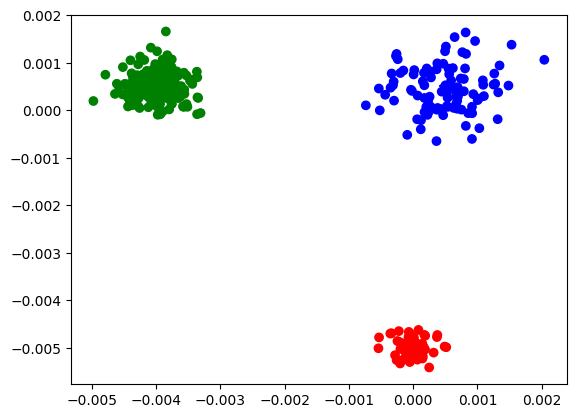

In [813]:
plt.scatter(*(data.T), color=colors)
for i in range(3):
    plt.scatter(gmm.mu[:, 0], gmm.mu[:, 1], color=color_map, marker='x')

In [802]:
a = np.array([[1,2,3], [4, 5, 6]])

In [129]:
a + np.array([2, 3, 4])

array([[ 3,  5,  7],
       [ 6,  8, 10]])

In [ ]:
%%timeit 
np.sqrt(2)

In [ ]:
%%timeit
math.sqrt(2)

In [94]:
%%timeit
math.exp(2)

122 ns ± 2.12 ns per loop (mean ± std. dev. of 7 runs, 10,000,000 loops each)


In [95]:
%%timeit
np.exp(2)

742 ns ± 27.2 ns per loop (mean ± std. dev. of 7 runs, 1,000,000 loops each)


In [114]:
np.array([[2, 4], [6, 8]]) / np.array([[1], [2]])

array([[2., 4.],
       [3., 4.]])

In [636]:
s = np.array([[[1, 1], [1,1]], [[2, 2], [2, 2]]])
s / np.array([[[1]], [[2]]])

array([[[1., 1.],
        [1., 1.]],

       [[1., 1.],
        [1., 1.]]])

In [637]:
np.array([[[1]], [[2]]]).shape

(2, 1, 1)